# Trabajo Práctico Especial de Señales y Sistemas

<h2 class="pm-node nj-subtitle">Identificación de canciones mediante huellas digitales acústicas</h2>

**Alumno**: Javier Hernán Ferreyra Iañez

**Número de Padrón**: 100680

**Docente Titular**: Leonardo Javier Rey Vega

**JTP**: Rui Alejandro Marques Rojo

# Código auxiliar

In [1]:
# Cargo paquetitos
using DSP, FFTW
using DSP.Windows: hamming, rect, hanning
using WAV
using FileIO
using Images
using LibSndFile
using Statistics
using SampledSignals
using Printf
using Plots
using IterTools
using Markdown
gr()

function wavread_mono(file)
    x, sr = wavread(file)
    return mean(x; dims=2)[:], sr
end

# Y armo un par de funciones auxiliares
stem(args...; kwargs...) = sticks(
    args...; 
    marker=:circle, 
    leg=false, 
    kwargs...
)
stem!(args...; kwargs...) = sticks!(
    args...; 
    marker=:circle, 
    leg=false, 
    kwargs...
)

zeropolegain(pr) = DSP.ZeroPoleGain(pr)
zeropolegain(z, p, g) = DSP.ZeroPoleGain(z, p, g)
polynomialratio(zpg) = DSP.PolynomialRatio(zpg)
function polynomialratio(b, a)
    n = max(length(a), length(b))
    return DSP.PolynomialRatio(padright(b, n), padright(a, n))
end
getpoles(zpg) = DSP.ZeroPoleGain(zpg).p
getzeros(zpg) = DSP.ZeroPoleGain(zpg).z
getgain(zpg) = DSP.ZeroPoleGain(zpg).k
getnumcoefs(pr) = trimlastzeros!(reverse(DSP.PolynomialRatio(pr).b.coeffs))
getdencoefs(pr) = trimlastzeros!(reverse(DSP.PolynomialRatio(pr).a.coeffs))
function trimlastzeros!(a)
    !iszero(a[end]) && return a
    pop!(a)
    return trimlastzeros!(a)
end

DSP.filt(zpg::DSP.ZeroPoleGain, r...; kwargs...) = filt(polynomialratio(zpg), r...; kwargs...)


function zplane(zs, ps; kwargs...)
    scatter(real.(zs), imag.(zs);
    marker = (:black, :circle), label="Cero", kwargs...)
    scatter!( real.(ps), imag.(ps);
    marker = (:red, :xcross), label="Polo", kwargs...)  
    ts = range(0,stop=2pi;length=100)
    plot!(cos.(ts), sin.(ts); aspect_ratio = 1, kwargs...)
end
zplane(pr::DSP.PolynomialRatio; kwargs...) = zplane(DSP.ZeroPoleGain(pr); kwargs...)



# Delta
d(n) = n == 0 ? 1. : 0. 

# Escalón
u(n) = n >= 0 ? 1. : 0. 

using Plots
Plots.default(:legend, false)

# Pad vector with zeros on the right until its length is `n`
padright(x, n) = copyto!(zeros(eltype(x), n), x)

"""
Función módulo pero con offset (opcional)
Manda a `t` al intervalo [from, from+length)
sumándole o restándole algún múltiplo de `len`
"""
cshift(t, len, from=0) = mod(t - from, len) + from

# Espectrograma
using IterTools
function stft(x; overlap, window, nfft, rest...)
    nwin = length(window)
    @assert overlap < nwin

    res = [ fft(padright(xseg .* window, nfft))
    for xseg in partition(x, nwin, nwin - overlap)]

    return [ res[i][j] for j in 1:nfft, i in eachindex(res)]
end


specplot(x::AbstractMatrix; kwargs...) = 
    @error "You are entering a Matrix (2D Array). I need a Vector (1D Array)."
    function specplot(
        x::AbstractVector;
        fs=1,
        onesided=false,
        xaxis="Tiempo (s)",
        yaxis="Frecuencia (Hz)",
        window=hamming(div(length(x), 16)),
        overlap=0.5,
        nfft=length(window),
        kws...
    )

        window isa Integer && (window = rect(window))
        overlap isa AbstractFloat && (overlap = round(Int, length(window) * overlap))

        mat = stft(x; overlap=overlap, window=window, nfft=nfft)

        fmax = fs
        if onesided
            mat = mat[1:div(size(mat, 1) + 2, 2), :]
            fmax = fs/2
        end

        toffset = length(window) / 2fs
        times = range(toffset; length=size(mat, 2), stop=length(x)/fs - toffset)
        freqs = range(0; length=size(mat, 1), stop=fmax)

        # Reubico las frecuencias negativas arriba de todo
        if !onesided
            freqs = cshift.(freqs, fs, -fs/2)
            ord   = sortperm(freqs)
            mat   = mat[ord, :]
            freqs = freqs[ord]
        end

        return heatmap(times, freqs, log.(abs.(mat) .+ eps());
                        xaxis=xaxis, yaxis=yaxis,
                        seriescolor=:bluesreds, legend=true, kws...)
        return times, freqs, mat
    end

function specplot(x :: AbstractVector{<:AbstractFloat}; kws...)
    return specplot(convert.(Complex, x); onesided=true, kws...)
end


specplot (generic function with 3 methods)

# Canciones a procesar

El audio corto con el que deben hacer los primeros ejercicios:

[Pink.ogg](https://nextjournal.com/data/Qma4iQGJE4H5ZA7CvQWvftWEvMnGGsz2FewxtT4iE4FmPD?content-type=audio/ogg&node-id=1d17d719-82f5-4468-9c9b-3e52ae582cc6&filename=Pink.ogg&node-kind=file)

Otras 40 canciones en \`ogg\`, estéreo, a 44100 Hz

In [2]:
pink = "Pink.ogg";
songsdir = "40songs"
songs = map(
    x -> joinpath(songsdir, x), 
    filter(
        x -> (last(x, 4) == ".ogg"), 
        readdir(songsdir)
    )
);
test_recording = "record.ogg";

[Aerosmith - Crazy.ogg](https://nextjournal.com/data/QmehxVTdCY3xbNMUXdUdhCCi1FCUeiVZmwoeApNiudJT2D?content-type=audio/ogg&node-id=bbfb4ad2-ac87-42c4-9d81-5dd6dbd66209&filename=Aerosmith%20-%20Crazy.ogg&node-kind=file)

[Bon Jovi - Bed Of Roses.ogg](https://nextjournal.com/data/QmTGijLTZNyczq9kTdY2ZTRvegbotxFdZ28WjvtYsaw2mh?content-type=audio/ogg&node-id=49326fac-487a-4946-bd85-19f06c395d94&filename=Bon%20Jovi%20-%20Bed%20Of%20Roses.ogg&node-kind=file)

[Meat Loaf - I'd Do Anything For Love (But I Won't Do That).ogg](https://nextjournal.com/data/QmboESVPti1ioN3JH8qX9BEEwJeP5gE7mtkkCvXhVvX11R?content-type=audio/ogg&node-id=945eb103-2b23-45bd-8124-4728f953e3af&filename=Meat%20Loaf%20-%20I%27d%20Do%20Anything%20For%20Love%20%28But%20I%20Won%27t%20Do%20That%29.ogg&node-kind=file)

[Keith Sweat - Twisted.ogg](https://nextjournal.com/data/QmX6SwpdGRcwkuygaCbXtpMVbAoBFuYugS8u7FhiyAt5Kv?content-type=audio/ogg&node-id=2ae06fa3-a5a7-4e29-b229-77ca5f7b4b4f&filename=Keith%20Sweat%20-%20Twisted.ogg&node-kind=file)

[Mariah Carey - Hero.ogg](https://nextjournal.com/data/Qmcumhr5LxcUJ1b6CvxZUCZA9EVw8RYZD2rLx8PfeLozz6?content-type=audio/ogg&node-id=64337d47-9cd4-4c2b-914f-cb13fb9dd87e&filename=Mariah%20Carey%20-%20Hero.ogg&node-kind=file)

[Big Mountain - Baby I Love Your Way(1994).ogg](https://nextjournal.com/data/QmdKXWDR7DLP498qHgXFjC9SJ8uY6CS8XEZUDonf3vZDTj?content-type=audio/ogg&node-id=de939fa0-4d89-4fb1-b32d-7aa7d1bbae46&filename=Big%20Mountain%20-%20Baby%20I%20Love%20Your%20Way%281994%29.ogg&node-kind=file)

[Bon Jovi - Always.ogg](https://nextjournal.com/data/QmYDVqXcr6uDooq6VeH3UCgdEakRwsyh2N841w9ohbCP4j?content-type=audio/ogg&node-id=10c021ff-0afc-4db4-b0d3-1ef5b68ac0fe&filename=Bon%20Jovi%20-%20Always.ogg&node-kind=file)

[Coolio - Gangsta's Paradise (feat. L.V.).ogg](https://nextjournal.com/data/QmW4qNxpv6w5WCkzw26tgjVVFBo8nFr6VFteYdJHRP1Uoc?content-type=audio/ogg&node-id=6cd4525b-c359-490f-80d4-67502a3dab6d&filename=Coolio%20-%20Gangsta%27s%20Paradise%20%28feat.%20L.V.%29.ogg&node-kind=file)

[Eric Clapton - My Father's Eyes.ogg](https://nextjournal.com/data/QmXSvpaZj2i2h8dNu4YyTXHLgpnHR5ConmLdDBgicD2X8B?content-type=audio/ogg&node-id=7b31fa9f-43e9-4f6e-9cea-46f313beae17&filename=Eric%20Clapton%20-%20My%20Father%27s%20Eyes.ogg&node-kind=file)

[Guns N' Roses - Don't Cry.ogg](https://nextjournal.com/data/QmdU6HHFmFtwzSrESuHTX7pnbpLHXUZDsWaQPwUHQKGNYc?content-type=audio/ogg&node-id=73c05991-50fa-4ca9-8ebd-b21c961e6f12&filename=Guns%20N%27%20Roses%20-%20Don%27t%20Cry.ogg&node-kind=file)

[Aerosmith - I Don't Want to Miss a Thing.ogg](https://nextjournal.com/data/QmbnMiVRsogUKi1SLNEjJ5kXmD4tmHDXhr7kkfifoAYFmA?content-type=audio/ogg&node-id=171e9c01-5531-49b4-bf7e-63cacd8a0f07&filename=Aerosmith%20-%20I%20Don%27t%20Want%20to%20Miss%20a%20Thing.ogg&node-kind=file)

[Lou Bega - Mambo No. 5 (A Little Bit of...).ogg](https://nextjournal.com/data/QmS1Y7VfZCPhRoeuUP8XYcGJLzqfV8ZksxCmSH8wA4H6ep?content-type=audio/ogg&node-id=778ea94f-dfac-4973-8dec-42093a7dc049&filename=Lou%20Bega%20-%20Mambo%20No.%205%20%28A%20Little%20Bit%20of...%29.ogg&node-kind=file)

[Eric Clapton - Wonderful Tonight.ogg](https://nextjournal.com/data/Qmf1xTxjuuq6uS626QprzZBfA5fwMeT4K5ZFsStHY81hvZ?content-type=audio/ogg&node-id=b73e6eb4-d861-4109-82e1-bc38bf252501&filename=Eric%20Clapton%20-%20Wonderful%20Tonight.ogg&node-kind=file)

[Bryan Adams - Please Forgive Me.ogg](https://nextjournal.com/data/QmRRBGqao9WRMiUmF2BZnFVTDJb3Ww6Cha5ZD3j2YkBYBP?content-type=audio/ogg&node-id=66e20c53-d903-41c8-89ed-98c01fb32eb3&filename=Bryan%20Adams%20-%20Please%20Forgive%20Me.ogg&node-kind=file)

[Bryan Adams - (Everything I Do) I Do It For You - Live in Canada.ogg](https://nextjournal.com/data/QmVVNrS6VfJc7xAVvhHm63K6D6Ns8Tu4Gx2aJ8H4bm3USo?content-type=audio/ogg&node-id=0c4e5607-7c1e-4fa0-a662-d6efdb00378d&filename=Bryan%20Adams%20-%20%28Everything%20I%20Do%29%20I%20Do%20It%20For%20You%20-%20Live%20in%20Canada.ogg&node-kind=file)

[Alanis Morissette - Head Over Feet.ogg](https://nextjournal.com/data/QmbgeaJuEST5gVnnyrVWogPpdVJj5JQVUngAh1e85TxzCk?content-type=audio/ogg&node-id=ee905860-bbb3-49f1-bb77-e4f332f6ebff&filename=Alanis%20Morissette%20-%20Head%20Over%20Feet.ogg&node-kind=file)

[Alanis Morissette - You Oughta Know.ogg](https://nextjournal.com/data/QmRpFsdsd8yG6gwkffEDgURN8aKvDYwvywmUqyDdqXvEei?content-type=audio/ogg&node-id=3e91ed3e-b135-44a5-9b46-b8b6fd0b7dd4&filename=Alanis%20Morissette%20-%20You%20Oughta%20Know.ogg&node-kind=file)

[4 Non Blondes - What's Up.ogg](https://nextjournal.com/data/QmRKf3xg67DWvQftPmhrC6up52sebEQc3iH9GKrBxdEkVa?content-type=audio/ogg&node-id=3c3ded63-12ca-42a7-aa76-c96f18a1253d&filename=4%20Non%20Blondes%20-%20What%27s%20Up.ogg&node-kind=file)

[Metallica - Enter Sandman.ogg](https://nextjournal.com/data/QmRbaYb63djQvJfJHaCXpUyrz84QNGr38jMH1u57zYEN5e?content-type=audio/ogg&node-id=d71b592e-8f2c-49b8-908f-44ac6c8af770&filename=Metallica%20-%20Enter%20Sandman.ogg&node-kind=file)

['Filthy Rich' Since I.ogg](https://nextjournal.com/data/QmeUrb1nSQCbGSTHxokgppdXediuPrByGfJGY6cLfShuZP?content-type=audio/ogg&node-id=2d859b56-7ad4-470f-8fe0-0ee26e2856ce&filename=%27Filthy%20Rich%27%20Since%20I.ogg&node-kind=file)

[Christopher Cross - Ride Like The Wind.ogg](https://nextjournal.com/data/QmbqFfXRRhHoc5g2brB15qsjzZNr6jLt4rwiaz4dK5TTFY?content-type=audio/ogg&node-id=49821705-ffb8-455f-8f33-5182abca9152&filename=Christopher%20Cross%20-%20Ride%20Like%20The%20Wind.ogg&node-kind=file)

[Eric Clapton - Tears In Heaven.ogg](https://nextjournal.com/data/QmfXM8JCVuUi4VcQF51frpy7ZwJfHacbo7XDncpSR2rZtH?content-type=audio/ogg&node-id=dce67a40-5f18-4606-b414-4c26861169c3&filename=Eric%20Clapton%20-%20Tears%20In%20Heaven.ogg&node-kind=file)

[Green Day - Basket Case.ogg](https://nextjournal.com/data/QmNjKt1rZNBzviGoMYQKAm1PcDZbz9fSRmv8SpaPGbPZvK?content-type=audio/ogg&node-id=2e439a46-511f-44c3-9b94-4e8e1ea67f45&filename=Green%20Day%20-%20Basket%20Case.ogg&node-kind=file)

[Aqua - Barbie Girl.ogg](https://nextjournal.com/data/QmQTjtdkLuVKn1XfQUKiaGBPDmCopYz41E9x4FUW9Unnbo?content-type=audio/ogg&node-id=3c4c3148-1988-4ebb-ab10-d0b2afe92e8a&filename=Aqua%20-%20Barbie%20Girl.ogg&node-kind=file)

[En Vogue - Don't Let Go (Love).ogg](https://nextjournal.com/data/QmQoikwbvxqfbUr3gnn7fLSEYNogjSzZm7STFMN9nQntB1?content-type=audio/ogg&node-id=9b1c8002-0074-4b2e-91ac-8cd2689500c0&filename=En%20Vogue%20-%20Don%27t%20Let%20Go%20%28Love%29.ogg&node-kind=file)

[Extreme - More Than Words.ogg](https://nextjournal.com/data/QmXmkAABSoYE2PEm1j3oCUKf4DchZWqKZt1CYwDAAk8wpm?content-type=audio/ogg&node-id=0af0e782-a649-4558-bfe0-a318bdb0830b&filename=Extreme%20-%20More%20Than%20Words.ogg&node-kind=file)

[Cher - Believe.ogg](https://nextjournal.com/data/QmTJrNix9QcW89GF5GREeoHv4pxjb4U2vkueMKhtZSPpnM?content-type=audio/ogg&node-id=233d6eb7-3770-455a-818e-3a5f9ab60a33&filename=Cher%20-%20Believe.ogg&node-kind=file)

[Alanis Morissette - Ironic.ogg](https://nextjournal.com/data/QmX6FQHpTd6Jwjqp1fnNkaVz8K16ySCTZYTm2hbBvAm7kr?content-type=audio/ogg&node-id=a0b8a82c-1ffe-4ea1-b4c9-bb68ae35dc25&filename=Alanis%20Morissette%20-%20Ironic.ogg&node-kind=file)

[Mark Morrison - Return Of The Mack.ogg](https://nextjournal.com/data/QmXjCb3LAqXtHyTF6FuJA4tFHWcKXxuFkCKCcLE7sibKyD?content-type=audio/ogg&node-id=60499b70-4907-4e15-afc3-aab8e2d4e1ab&filename=Mark%20Morrison%20-%20Return%20Of%20The%20Mack.ogg&node-kind=file)

[Mariah Carey - Without You.ogg](https://nextjournal.com/data/QmX2RaXedjjnKFC1V94r4aumiFKdkgjAWAZQpxbdSA4Hg1?content-type=audio/ogg&node-id=c72ca547-ff4c-43d4-8d9d-489fed12a964&filename=Mariah%20Carey%20-%20Without%20You.ogg&node-kind=file)

[Mariah Carey - Always Be My Baby.ogg](https://nextjournal.com/data/QmYs2krPZWWTME7pSa3qpJoMTW5WKqXoCovGdgKCmy8eRz?content-type=audio/ogg&node-id=8a1756b6-044d-46de-9817-b8582991021a&filename=Mariah%20Carey%20-%20Always%20Be%20My%20Baby.ogg&node-kind=file)

[Bloodhound Gang - The Bad Touch.ogg](https://nextjournal.com/data/QmRfgU5qSWfjmRsoZe3p8WMeuKyYwtnUYtcTGQG4GjZdE9?content-type=audio/ogg&node-id=bdd5b5f5-0e15-4f06-88ea-7f7cec587f6a&filename=Bloodhound%20Gang%20-%20The%20Bad%20Touch.ogg&node-kind=file)

[Goo Goo Dolls - Iris.ogg](https://nextjournal.com/data/QmeiESiWhcrxnvznWue7oxnjq9wEXnrS9JBr53VvHzzUBr?content-type=audio/ogg&node-id=6fadeac2-e1b9-4371-8741-d34ba3eeddf9&filename=Goo%20Goo%20Dolls%20-%20Iris.ogg&node-kind=file)

[Dr. Dre ft. Snoop Dogg, Kurupt, Nate Dogg - The Next Episode.ogg](https://nextjournal.com/data/QmNgJi39cqC7nG7c23siqSn9cfu79diFvgzRPGWnvJoNvM?content-type=audio/ogg&node-id=d07762c6-a762-42d9-bdd0-01c25a6e1a43&filename=Dr.%20Dre%20ft.%20Snoop%20Dogg%2C%20Kurupt%2C%20Nate%20Dogg%20-%20The%20Next%20Episode.ogg&node-kind=file)

[Britney Spears - ...Baby One More Time.ogg](https://nextjournal.com/data/QmeR3bj2LXD1N7LvvsxSu5acxPLZQ7vbYzK9BGf33qcbDK?content-type=audio/ogg&node-id=0b958876-ac88-43e8-a1c7-d65767cca893&filename=Britney%20Spears%20-%20...Baby%20One%20More%20Time.ogg&node-kind=file)

[Hootie & The Blowfish - Let Her Cry.ogg](https://nextjournal.com/data/QmVKieTzBabNJLMdomN99XGLpWBWS234Fgxpe2PFbeNc1y?content-type=audio/ogg&node-id=0ece1c71-93e0-4a1c-bdf3-c0d12bf082c3&filename=Hootie%20%26%20The%20Blowfish%20-%20Let%20Her%20Cry.ogg&node-kind=file)

[Brandy & Monica - The Boy Is Mine.ogg](https://nextjournal.com/data/QmfKSVe5pyQCZPXsrbBrBcheoi8xVMJeDD79ER8AMkAtCD?content-type=audio/ogg&node-id=4e10535a-fd84-43ac-bf0d-52753bfd0cfb&filename=Brandy%20%26%20Monica%20-%20The%20Boy%20Is%20Mine.ogg&node-kind=file)

[Fugees - Killing Me Softly With His Song.ogg](https://nextjournal.com/data/Qmbg4QNPF1mDN2ao3Pa756EXJJP2mugf9qTqu1RhrCvBAc?content-type=audio/ogg&node-id=ecafe0f5-b3d9-4e28-9e1b-babd21df4c54&filename=Fugees%20-%20Killing%20Me%20Softly%20With%20His%20Song.ogg&node-kind=file)

[Blur - Song 2-SSbBvKaM6sk.ogg](https://nextjournal.com/data/QmcAWwh5BMw9zKcv9AJJ3GY4Y2nLw6zFp5XYyvqQqnp7rP?content-type=audio/ogg&node-id=0557754e-2510-42ee-b426-9c7673a2be48&filename=Blur%20-%20Song%202-SSbBvKaM6sk.ogg&node-kind=file)

# Introducción

Imaginen la siguiente situación: se encuentran en un bar, tomando su trago favorito, inmersos en esa interesante conversación cuando de repente . . .  “pará, pará, ¿qué es eso que suena?”. Entre el ruido general alcanzan a distinguir esa canción que no escuchaban en tanto tiempo, que habían obsesivamente intentado encontrar pero que, a pesar de ello, nunca llegaron a dar siquiera con el nombre del intérprete. Su corazón se estremece . . .  Ahora que la tienen ahí, sonando nuevamente, la situación es bien diferente a la de hace algunos años: toman su teléfono celular, abren alguna de las aplicaciones de reconocimiento de audio que tienen y, en cuestión de segundos, aparece la información completa del tema, la banda, ¡e incluso se atreve a sugerir artistas similares!

Si el protagonista de esta ficción fuera estudiante de Señales y Sistemas, no debería extrañarnos que surjan en él varios interrogantes: ¿cómo hizo el programa para reconocer la canción escuchando sólo 10 segundos?, ¿cómo puede funcionar con el ruido de un bar de fondo? y ¿cómo pudee ser que además identifique tan rápido a seta banda que nadie conoce?

Resulta que todo este proceso se basa en reconocer *huellas digitales acústicas*, una técnica robusta y eficiente que puede entenderse en términos de Señales y Sistemas.

## Reconocimiento mediante huellas digitales acústicas

El reconocimiento de audio mediante huellas digitales acústicas es una técnica que busca identificar una pieza de audio, contrastando la información contenida en dicha pieza contra la almacenada en una base de datos de pistas conocidas. Esta técnica comienza a desarrollarse desde el año 2000, pero es durante la última década que tomé mayor impulso, siendo posible hoy en día encontrar una variedad de aplicaciones para smartphones capaces de identificar casi cualquier pieza de audio en segundos \[4\].

Existen varias formas dea bordar el problema del reconocimiento, pero todas persiguen la misma finalidad:

* Simplicidad computacional: el reconocimiento debe realizarse en forma rápida.
* Eficiencia en el uso de memoria y buena capacidad de discriminación: existen aproximadamente 100 millones de canciones grabadas \[1\].
* Robustez ante degradaciones: ruido de fondo, degradación por compresión digital del audio, ecualización por respuesta en frecuencia no plana del lugar y/o parlantes, etc.
* Granularidad: capacidad de reconocimiento utilizando sólo un segmento del audio.
* Alta tasa de aciertos, baja tasa de falsos positivos y de rechazos.

El procedimiento básico consiste en analizar el segmento de audio buscando extraer características particulares en el esapcio tiempo-frecuencia (es decir, en su espectrograma) que sirvan para identificarlo luego. Una característica podría ser, por ejemplo, la potencia que posean las diferentes bandas de frecuencias. Al conjunto de estas características se las denomina *huella digital acústica*.

![sys-tpe1.png](https://nextjournal.com/data/QmQ8VdSoTLuo3zVWYrpwjCYVw9erkCppZ6WAN3mASrHeFC?content-type=image/png&node-id=ef6754e8-5d74-4845-84f0-1d40f1e86c3f&filename=sys-tpe1.png&node-kind=file)

Este procedimiento de extracción de huellas se utiliza tanto para confeccionar la base de datos de canciones conocidas como para posteriormente reconocer segmentos de audio que se desean identificar consultando la base de datos.

La elección de las características es la base del funcionamiento del método. Deben ser lo suficientemente específicas como para identificar a cada canción unívocamente pero a la vez ocupar poca memoria para permitir realizar la búsqueda en forma rápida y eficiente. También deberán ser relativamente inmunes ante ruidos y distorsiones del audio de manera de lograr un sistema de reconocimiento robusto.

Diferentes características han sido propuestas con el fin de lograr estas especificaciones. Algunos ejemplos que se extraen del dominio tiempo-frecuencia son los MFCC \[4\] (Mel-Frequency Cepstrum Coefficients, comúnmente utilizados para la representación del habla), SFM \[1\] (Spectral Flatness Measure, una estimación de cuánto se aproxima una banda espectral a ser un tono o ruido), la ubicación de los picos de potencia del espectrograma (la base del algoritmo de Shazam \[9, 8\]), la energía de las bandas \[6\], etc. Además del espectrograma, otras técnicas se han utilizados como *wavelets* y algoritmos de visión \[2\], algoritmos de machine learning \[3\], y meta-características \[7\], útiles en grabaciones muy distorsionadas.

En este trabajo desarrollaremos una implementación simple que utiliza como características el signo de la diferencia de energía entre bandas \[5\].

Cabe destacar que esta característica sólo sirve para reconocer las mismas versiones de las canciones que se almacenan en la base de datos: es decir, no está diseñada para reconocer versiones en vivo o interpretaciones diferentes a la original.

# Descripción del sistema de reconocimiento

El sistema de reconocimiento consta de dos bloques principales:

1. El algoritmo para extraer las huellas digitales acústicas.
2. La base de datos que almacena las huellas acústicas de las canciones conocidas y permite realizar búsquedas a partir de la huella acústica de una canción desconocida.

El algoritmo para extraer las huellas acústicas toma como entrada el archivo con el audio, lo pre-procesa, extrae las características, y entrega como resultado la huella acústica.

![sys-tpe2.png](https://nextjournal.com/data/QmRYiHJKoMuXyNybtpYDvExYoxBiwoA4dHQei9Quar5Sit?content-type=image/png&node-id=72271b09-84b8-4f0a-a167-654d0d1c6618&filename=sys-tpe2.png&node-kind=file)

La base de datos guardará las huellas acústicas de las canciones conocidas. Tiene además un sistema de búsqueda (en inglés query) tal que al realizar un query con una huella acústica dada nos devuelve la canción – más probable – a la cual correseponde.

El esquema del sistema completo se presenta a continuación:

![sys-tpe3.png](https://nextjournal.com/data/QmYQPVLaSUHo9XBXL2m3HqMnbA2QAY9jWg7VqoFeby8N77?content-type=image/png&node-id=8dd37ca5-8e47-4096-a858-4e2bc824904a&filename=sys-tpe3.png&node-kind=file)

Observe que el algoritmo de extracción de huellas se utiliza tanto en la creación de la base de datos de canciones conocidas como para el reconocimiento de audios desconocidos.

## Algoritmo de extracción de huellas digitales acústicas

El algoritmo de extracción de huellas acústicas tiene como finalidad extraer características a partir del espectrograma del audio. Primeramente, se acondiciona el audio con un pre-procesamiento. Luego se realiza un espectrograma del audio pre-procesado y finalmente se extraen las características para cada intervalo de tiempo.

### 1. Pre-procesamiento del audio

Se comienza convirtiendo el audio, que suele ser estar en estéreo, a un audio monocanal, promediando los canales.

Luego, se reduce su frecuencia de muestreo, aprovechando que son las frecuencias bajas las que contienen la información más útil para la extracción de características. En general, el audio está muestreado a 44100 Hz (calidad de CD), pero para este algoritmo de reconocimiento basta con tenerlo muestreado a 1/8 de su frecuencia original, 5512.5 Hz. Esto permite trabajar con menos muestras, aliviando la carga computacional.

Para realizar los siguientes ejercicios, utilice el archivo *Pink.ogg*.

#### Ejercicio 1)

***Cargue la pista de audio. Verifique que la variable cargada es una matriz con 2 columnas, cada una correspondiendo a un canal de audio. Promedie los canales utilizando al función mean para tener 1 solo canal y grafique una porción de la señal resultante. Verifique que el audio resultante sea similar al original escuchándolo.***

In [3]:
const sr = 44100

44100

In [4]:
function loadaudio(fn)
    xraw = load(fn)
	# Chequeo que la frecuencia de muestreo sea `sr`
    @assert samplerate(xraw) == sr  samplerate(xraw)
    return collect(xraw)
end;

Primero cargamos el segmento de audio a utilizar verificando que se obtiene una matriz de dos columnas.

In [5]:
begin
    data = loadaudio(pink)
    size(data)
end

(441000, 2)

Promediamos los canales obteniendo un solo canal, verificamos que el resultado sea una matriz de tamaño 441000x1

In [6]:
function convertir_a_mono(data)
    mean(data, dims=2)
end;

In [7]:
begin
    mono = convertir_a_mono(data)
    size(mono)
end

(441000, 1)

Finalmente reproducimos ambos segmentos de audio para verificar que el promediado es similar al original.

In [8]:
SampleBuf(data, sr)

441000-frame, 2-channel SampleBuf{Float32, 2}
10.0s sampled at 44100.0Hz
█▇▇▇██▇▇█▇▇█▇█████▇▇▇▇█▇▇▇▇██▇█▇▇█▇▇▇▇██▇▇▇▇█▇▇▇▇▇█▇▇█▇█▇▇▇▇▇█▇▇▇▇██▇▇▇██▇▇█▇▇█▇
█▇▇▇██▇▇██▇█▇██▇█▇▇▇▇▇█▇▇▇▇██▇█▇▇█▇▇█▇▇█▇▇▇▇██▇▇▆▇█▇▇█▇█▇▇█▇▇██▇▇▇▇█▇▇▇██▇▇█▇▇█▇

In [9]:
SampleBuf(mono, sr)

441000-frame, 1-channel SampleBuf{Float32, 2}
10.0s sampled at 44100.0Hz
█▇▇▇██▇▇██▇▇▇██▇█▇▇▇▇▇▇▇▇▇▇▇█▇█▇▇▇▇▇▇▇██▇▇▇▇▇▇▇▇▇▇█▇▇▇▇█▇▇▇▇▇█▇▇▇▇▇█▇▇▇▇█▇▇█▇▇█▇

#### Ejercicio 2)

***Mediante la función fft, realice un análisis espectral de la señal mostrando la densidad espectral de potencia (PSD) en función de la frecuencia en Hz.  Verifique que la mayor PSD se concentra en las bajas frecuencias. Utilice escala logarítmica para mostrar el resultado.***

***La PSD,*** $S_{XX}$, la puede estimar como $S_{X X}(\omega) = 1/T |X(\omega)|^2$, donde $T$ es la duración del segmento temporal que usa para la estimación, o mejor aún, dividiendo al audio en segmentos, realizando la estimación anterior con cada uno, y finalmente promediándolas.

Definimos una función que me calcula la PSD (estimada) a partir de una muestra de audio.

In [10]:
#calculo de psd
function psd(sample)
    #obtengo dft
    dft = fft(sample)
    
    #devuelvo la estimacion usando la dft
    return 1/(sr*length(sample)) * abs.(dft).^2
end;

Luego, definimos otra función que divide el audio en *n* segmentos, calcula la PSD para cada uno de ellos y luego calcula el promedio para cada frecuencia.

In [11]:
#calculo de psd dividiendo en n segmentos
function splitpsd(sample, n)
    partition_size = length(sample)÷n
    @assert partition_size == length(sample)/n "splitpsd: El tamaño de la muestra debe ser divisible por la cantidad de segmentos"
    #divido la muestra en n segmentos usando un array de n arrays
    partitions = collect(sample[k*partition_size + 1 : (k+1)*partition_size] for k in [0:n-1;])
    #aplico psd a cada segmento en el array
    split_psd = collect(psd(p) for p in partitions)
    
    #convierto el array de arrays a un array 2D donde cada columna es un psd
    #despues obtengo el promedio por fila
    mean(reshape(hcat(split_psd...), partition_size, n), dims=2)
end;

Ahora graficamos la PSD que obtenemos para la muestra de audio.

Para realizar el gráfico en unidades de Hz, debemos tener en cuenta que estamos calculando el espectro de una señal discreta por lo cual el mismo va a ser periódico con período $2\pi$. Pero esa señal discreta corresponde a muestras tomadas a una tasa de 44100Hz de una señal de audio analógica, entonces (asumiendo que no hay aliasing), si graficamos el resultado que obtenemos entre $-\pi$ y $\pi$, eso representa al espectro de la señal original entre $-22050Hz$ y $22050Hz$

In [12]:
function plotpsd(sample, segments)
    psd1 = splitpsd(sample, segments)
    
    n = length(psd1)
    N = length(sample)
    println("Sample size: ", N)
    println("PSD size: ", n)
    
    y = fftshift(psd1)
    x = range(-sr/2000, sr/2000, length=length(y))
    plot(
        x,10*log10.(y), 
        xlabel="Frecuencia (KHz)", 
        ylabel="PSD (dB)", 
        title=string("PSD promediada utilizando ", segments, " segmentos"),
        xlims=(0, sr/2000)
    )
    
end;

Sample size: 441000
PSD size: 441


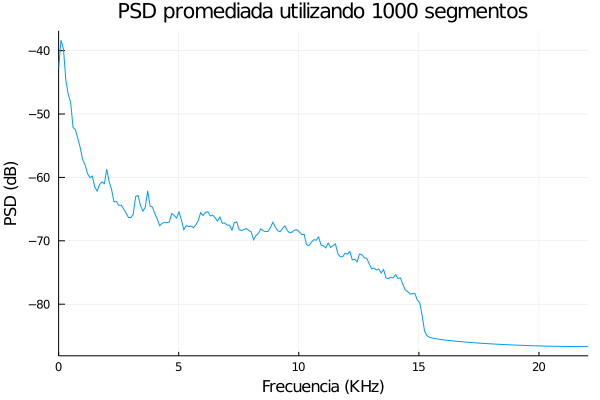

In [13]:
plotpsd(mono, 1000)

#### Ejercicio 3)

**Mediante la función fft, obtenga el espectro de una ventana rectangular y una de Hamming de igual duración y grafique su potencia en escala logarítmica en un mismo gráfico para compararlos. ¿Cuál es la resolución en frecuencia de cada ventana? Al realizar un espectrogama, ¿qué ventaja tiene utilizar la ventana de Hamming frente a la rectangular?**

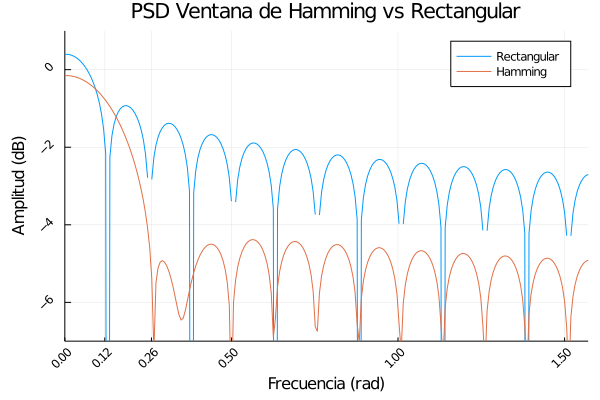

In [14]:
begin
    n = 50
    padding = 950
    len = n + padding

    ham_wdw = hamming(n, padding=padding)
    rect_wdw = rect(n, padding=padding)

    ham_psd = 1/len * abs.(fftshift(fft(ham_wdw))).^2
    rect_psd = 1/len * abs.(fftshift(fft(rect_wdw))).^2

    x = range(-pi, pi; length = len)

    plot(x, log10.(rect_psd), label="Rectangular", legend=true)
    plot!(x, log10.(ham_psd), label="Hamming")
    ylims!(-7,1)
    xlims!(0,pi/2)
    title!("PSD Ventana de Hamming vs Rectangular")
    xlabel!("Frecuencia (rad)")
    ylabel!("Amplitud (dB)")
    xticks!([-1.5, -1.0, -0.5, -0.26, -0.12, 0.0, 0.12, 0.26, 0.5, 1.0, 1.5], rotation=45)
end

Observamos que la resolución en frecuencia de la ventana es mayor en la ventana rectangular ya que tiene un lóbulo principal más estrecho. Observamos en el gráfico que su ancho es de aproximadamente 0.24 rad mientras que en la ventana de Hamming es 0.52 rad.

La ventaja que tiene la ventana de Hamming es que los lóbulos secundarios tienen una amplitud mucho menor por lo que se reduce la dispersión espectral, es decir que al convolucionar el espectro, el valor resultante para cada frecuencia se va a ver menos afectado por frecuencias lejanas.

La dispersión espectral podría causar, por ejemplo, que en el espectrograma aumente la magnitud en las frecuencias que deberían tener magnitud más baja, ya que los lóbulos secundarios altos harían que las frecuencias con mayor magnitud incidan en ella.

#### Ejercicio 4)

***Implemente un sistema para reducir la frecuencia de muestreo del audio, de 44100 Hz a 5512.5 Hz. Muestre un diagrama en bloques y justifique su diseño. Diseñe el filtro pasabajos mediante el método de ventaneo explicando y justificando las decisiones, de forma tal que su retardo sea menor a 1 ms. Graficar un diagrama de polos y ceros, respuesta en frecuencia (módulo y fase), respuesta al impulso, y retardo de grupo.***

El sistema deberá consistir en un filtro antialiasing pasa bajos y un diezmado con un factor M=8, es decir, quedarse solamente con una muestra cada ocho de las muestras originales. El filtro pasa bajos debe tener una frecuencia de corte de $\Omega = \pi/8$ ya que se quiere reducir la frecuencia a la octava parte.

![diagrama_bloques.png](https://nextjournal.com/data/QmQS4MusNmG32oYRyj3CT72NNsQXKgMcf2fzonUbLfK6h5?content-type=image/png&node-id=1ae01a23-e82e-4b92-a71d-12b3f300b9fb&filename=diagrama_bloques.png&node-kind=file)


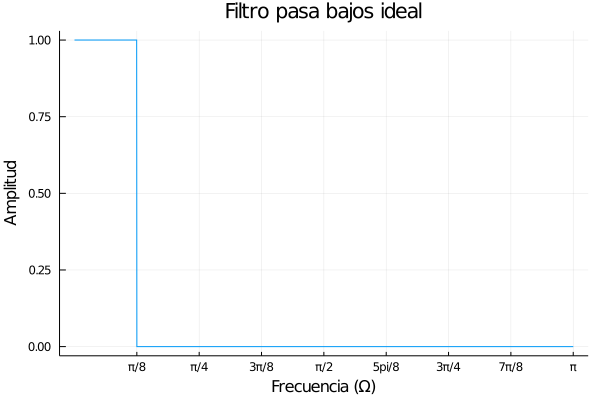

In [15]:
begin
    H_ideal(o) = u(o + pi/8) - u(o - pi/8)
    plot(H_ideal, 0, pi)
    xticks!(
        [pi/8, pi/4, 3pi/8, 4pi/8, 5pi/8, 6pi/8, 7pi/8, pi], 
        ["π/8", "π/4", "3π/8", "π/2", "5pi/8", "3π/4", "7π/8", "π"]
    )
    xlabel!("Frecuencia (Ω)")
    ylabel!("Amplitud")
    title!("Filtro pasa bajos ideal")
end

Sabemos que la antitransformada de esa ventana es una sinc, entonces podemos obtenerla analíticamente. Luego la muestreamos con período `T = 1` para que no se deforme el eje de frecuencias en el espectro y siga teniendo frecuencia de corte `π/8` en tiempo discreto. Además sabemos que no hay aliasing ya que la frecuencia de muestreo con `T = 1` es `ωs = 2π` lo cual mayor a dos veces la frecuencia de corte del filtro.

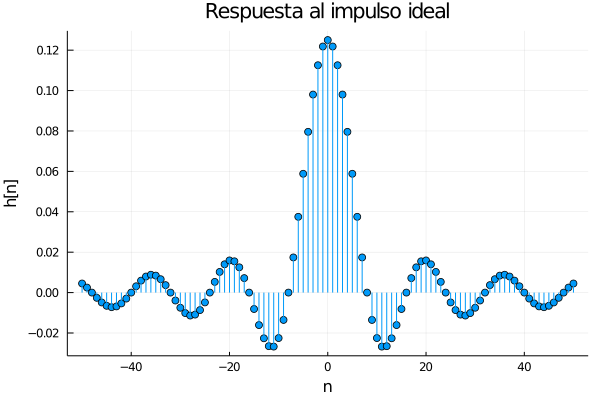

In [16]:
begin
    h_ideal(n) = 1/8 * sinc(1/8 * n)
    ns = -50:50
    stem(
        ns,
        h_ideal.(ns),
        title = "Respuesta al impulso ideal",
        xlabel = "n",
        ylabel = "h[n]"
    )
end

Ahora obtenemos el filtro multiplicando la respuesta al impulso por una ventana y desplazando.

Si quiero un retardo menor a 1ms necesito un filtro tal que al desplazarlo a derecha lo corra 44 puntos o menos ya que al tener 44100 muestras por segundo, en 1ms tengo 44,1 muestras.

Entonces vamos a elegir un orden de N=89 así lo desplazo (N-1)/2, es decir 44 puntos. Y además vamos a elegir la ventana de Hamming, ya que provee una menor dispersión espectral a costa de una menor resolución, lo cual no es molestia ya que esa baja resolución nos suaviza la discontinuidad que hay en el filtro ideal en pi/8, es decir 2756Hz en la señal acústica, pero para obtener la huella vamos a utilizar bandas de frecuencia entre 300Hz y 2000Hz, entonces no nos importa que la frecuencia de corte del filtro no esté bien definida.

In [17]:
function filtro(order)
    ns = range(-(order-1)/2; length = order)
    wdw = hamming(order)
    h_ideal.(ns) .* wdw    
end

filtro (generic function with 1 method)

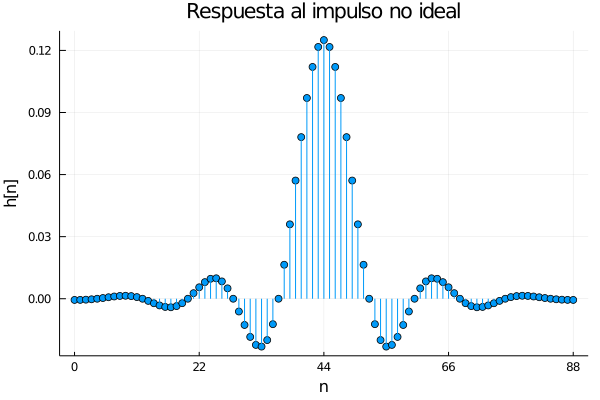

In [18]:
begin
    hs = filtro(89)
    stem(0:88, hs)
    xticks!([0, 22, 44, 66, 88])
    title!("Respuesta al impulso no ideal")
    xlabel!("n")
    ylabel!("h[n]")
end

Graficamos la respuesta en frecuencia del filtro (módulo, fase y retardo de grupo). Primero obtenemos el modulo y la fase y luego calculamos la derivada negativa de la fase para obtener el retardo de grupo ya que el corrimiento en tiempo de la señal por una constante equivale a una fase lineal en frecuencia con esa pendiente (por la propiedad de desplazamiento en tiempo de la TF).

In [19]:
#funcion auxiliar para calcular la derivada numericamente
function fdm(x, y)
    derivative = imap(((x1,x2), (y1,y2)) -> (y2-y1)/(x2-x1), partition(x, 2, 1), partition(y, 2, 1))
    collect(derivative)
end;

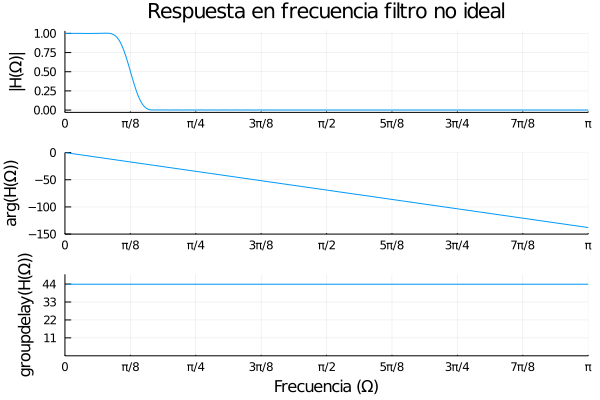

In [20]:
let
    samples = 500
    labels = (
        [0, pi/8, pi/4, 3pi/8, pi/2, 5pi/8, 3pi/4, 7pi/8, pi],
        ["0", "π/8", "π/4", "3π/8", "π/2", "5π/8", "3π/4", "7π/8", "π"]
    )
    x = range(0, 2pi, length = samples)
    y = padright(hs, samples)
    y = fft(y)
    y_modulo = (abs.(y))
    y_fase = unwrap(angle.(y), range=pi)
    y_groupdelay = -(fdm(x, y_fase))
    p1 = let
        plot(x, y_modulo)
        xlims!((0,pi))
        xticks!(labels)
        ylabel!("|H(Ω)|")
        title!("Respuesta en frecuencia filtro no ideal")
    end
    p2 = let
        plot(x, y_fase)
        xlims!((0, pi))
        xticks!(labels)
        ylims!((-150,0))
        ylabel!("arg(H(Ω))")
    end
    p3 = let
        plot(x[2:end], y_groupdelay)
        xlims!((0, pi))
        xticks!(labels)
        yticks!([11,22,33,44])
        ylims!((0, 50))
        xlabel!("Frecuencia (Ω)")
        ylabel!("groupdelay(H(Ω))")
    end
    plot(p1, p2, p3, layout = (3,1))
end

En este gráfico vemos que el filtro tiene fase lineal y el retardo es menor a ```1 ms```, ya que el mismo es de 44 muestras lo cual con una tasa de muestreo de `44100 Hz` equivale aproximadamente a ```0.998 ms```

Definimos el filtro como la convolución entre la señal y la respuesta al impulso.

In [21]:
filtrar(x) = conv(x, hs);

Ahora que tenemos la señal filtrada tenemos que submuestrearla tomando una muestra cada 8.

In [22]:
function submuestrear(x, M)
    collect(takenth(x,M))
end;

Implementamos el sistema final.

In [23]:
function sistema(x)
    submuestrear(filtrar(x), 8)
end;

Aplicamos el sistema a la canción muestreada original y escuchamos.

In [24]:
begin
    cancion_filtrada = sistema(mono)
    println("Longitud muestra original: ", length(mono))
    println("Longitud submuestreada: ", length(cancion_filtrada))
    SampleBuf(cancion_filtrada, sr/8)
end

Longitud muestra original: 441000
Longitud submuestreada: 55136


55136-frame, 1-channel SampleBuf{Float64, 1}
10.001995464852607s sampled at 5512.5Hz
▇▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇▇▇▇█▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇█▇▇▇▇

No nos queda exactamente la octava parte de la longitud original ya que estamos convolucionando la señal con una respuesta al impulso de longitud 89, entonces nos quedan 88 muestras más en el resultado. Por eso la longitud de la señal final es de 441088/8 = 55136

Para el diagrama de polos y ceros, como el filtro es FIR tenemos que los valores de la respuesta al impulso son los coeficientes de `x[n], x[n-1], ..., x[n-88]` en la ecuación en diferencias del filtro y por lo tanto tambien los coeficientes del numerador en al función de transferencia. Y ademas al ser FIR también el único coeficiente del denominador es 1 porque es el coeficiente de `y[n]` en la ecuación en diferencias.

Entonces obtenemos los polos y los ceros pasando el vector de la respuesta al impulso a `polynomialratio()` en el numerador, y 1 en el denominador , y luego usamos `getzeros()` y `getpoles()`.

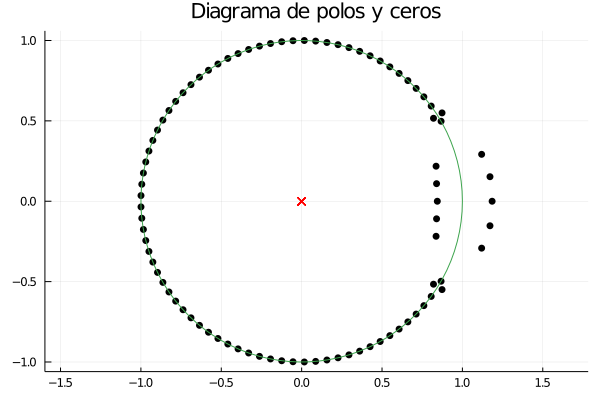

In [25]:
let
    pr = polynomialratio(hs, [1])
    zplane(getzeros(pr), getpoles(pr))
    title!("Diagrama de polos y ceros")
end

#### Ejercicio 5)

***Realice un espectrograma de la señal original y la filtrada y verifique los efectos del filtrado. Indique el tipo y longitud de ventana utilizada.***

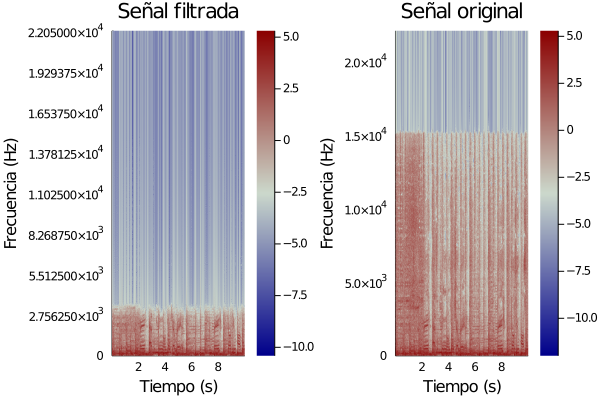

In [26]:
let
    p1 = specplot(
        filtrar(mono[1:end]), 
        fs=sr, 
        window = hamming(1024),
        yticks = range(0, sr/2, length=9),
        title = "Señal filtrada"
    )
    p2 = specplot(
        mono[1:end], 
        fs = sr,
        window = hamming(1024),
        title = "Señal original"
    )
    plot(p1, p2, layout=(1,2))
end

Realizando el espectrograma con una ventana de Hamming de longitud `1024` muestras, se observa los efectos del filtrado ya que en el espectrograma de la señal filtrada se ve que la frecuencia llega a aproximadamente `2756.25 Hz` que es una octava parte de `22050 Hz` (la frecuencia máxima con una tasa de muestreo de `44100 Hz`)

### Espectrograma

Los parámetros con los que se realice el espectrograma tienen una influencia directa sobre la extracción de las características. La elección de la ventana (tipo y longitud) es el parámetro principal, ya que debería lograr una resolución razonable tanto en tiempo como en frecuencia que permita distinguir las características espectrales y temporales con claridad.

#### Ejercicio 6)

***Realice un espectrograma de la señal sub-muestreada y muestre una imagen (con zoom) de alguna región donde se vean las características espectrales de la señal dada la ventana utilizada. Muestre y justifique cómo cambia la visualización de las características con 3 diferentes longitudes de ventana y comente qué longitud utilizará en el algoritmo. Realice las comparaciones con ventana rectangular y de Hamming.***

Primero mostramos un espectrograma general para poder darle un vistazo a grandes rasgos

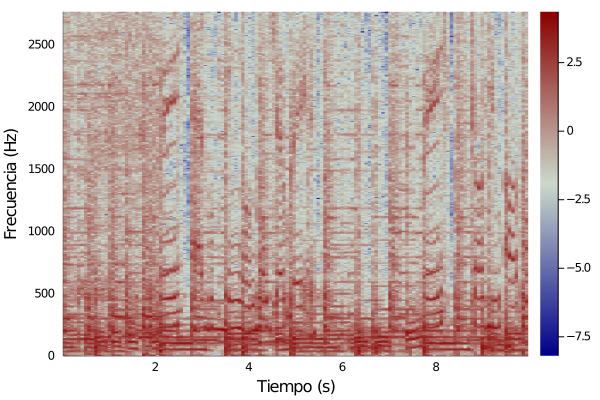

In [27]:
specplot(
    cancion_filtrada,
    fs = sr/8,
    window = hamming(800)
)

En este espectrograma observamos varias características de la señal como líneas horizontales, por ejemplo en la zona comprendida entre 2s y 4s, y entre 0Hz y 1000Hz, vamos a graficar esa región con diferentes anchos de ventana utilizando una ventana de Hamming y una rectangular.

In [28]:
let
    low = 1024
    mid = 2048
    high = 4096
    overlap = 31/32
    xlims = (2,4)
    ylims = (0, 1000)
    ham1 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = hamming(high),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    ham2 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = hamming(mid),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    ham3 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = hamming(low),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    rec1 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = rect(high),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    rec2 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = rect(mid),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    rec3 = specplot(
        cancion_filtrada,
        fs = sr/8,
        window = rect(low),
        ylims = ylims,
        xlims = xlims,
        overlap = overlap
    )
    plot(
        ham1, ham2, ham3, 
        rec1, rec2, rec3,
        layout = (2, 3),
        size = (1000, 600),
        title = [@sprintf("Hamming %i", high) @sprintf("Hamming %i", mid) @sprintf("Hamming %i", low) @sprintf("Rect %i", high) @sprintf("Rect %i", mid) @sprintf("Rect %i", low)]
    )
end

Se observa que con ventanas más grandes se obtiene una menor resolución en el tiempo y mayor resolución en frecuencia, y con ventanas más chicas se gana resolución en tiempo pero se pierde en frecuencia.

Esto se debe a que si la ventana es muy grande, estoy abarcando mucho tiempo para calcular cada DFT, por lo cual para un tiempo $t_0$ en realidad estoy obteniendo el espectro de un rango amplio de tiempos. Pero por otro lado, cuando la ventana es grande en tiempo, su espectro tiene un lóbulo principal más estrecho, por lo cual al convolucionar en frecuencia obtengo mayor resolucion.

Si la ventana fuese pequeña obtengo mayor precisión en tiempo pero en frecuencia convoluciono con una ventana cuyo espectro tiene un lóbulo principal más ancho, lo cual produce el efecto de "suavizar", por lo cual se pierde resolución.

Otra observación es que con la ventana rectangular, al tener un lóbulo principal más estrecho, se obtiene una mayor resolución en frecuencia, lo cual da el efecto de que las líneas horizontales se ven más definidas. Pero por otro lado, al tener lóbulos secundarios más altos, se tiene una mayor dispersión espectral, lo cual da el efecto mencionado en el ejercicio 3.

Para el algoritmo de reconocimiento vamos a utilizar una ventana de Hamming de longitud 2048.

In [29]:
begin
    ventana = hamming(2048)
    long_ventana = length(ventana)
end;

### Extracción de características

La función provista *stft* permite obtener la matriz $s$ con las sucesivas DFT de los segmentos de la señal ventaneados -- lo que se grafica en un espectrograma.

Estas DFT nos devuelven muestras del espectro en frecuencias equiespaciadas en escala lineal – junto con los vectores de tiempos y frecuencias correspondientes a cada columna y fila.

A partir de esto, necesitaremos la energía en bandas de frecuencia equiespaciadas en escala logarítmica (esto es similar a la escala psicoacústica Bark) debido a que así funciona el oído humano, que es un buen reconocedor de canciones – la relación entre frecuencias y posición de resonancia de la membrana basilar es aproximadamente logarítmica.

Debemos obtener una matriz de energías $E$, cuyas columnas, al igual que las de $s$, representan características espectrales del n-ésimo segmento de señal ventaneado (frame $n$). Para todo $n$, el elemento $E[m, n]$ de nuestra nueva matriz debe contener la energía total de todos los coeficientes de $s[k, n]$ asociados a frecuencias que caen dentro de la $k$-ésima banda de frecuencia.

#### Ejercicio 7)

***Divida al espectrograma en 21 bandas de frecuencias, equiespaciadas en escala logarítmica (es decir, el cociente entre frecuencias de bandas consecutivas debe ser constante). La frecuencia inferior de la primera banda debe ser 300 Hz y la superior de la última, 2 kHz. La función logspace le puede ser de ayuda.***

***Obtenga la*** $E[m, n]$.

In [30]:
function logspace(start, stop, num)
    10 .^(
        range(
            start, 
            stop,
            length = num
        )
    )
end;

In [31]:
function obtener_e(x, ventana, overlap)
    long_ventana = length(ventana)
    window = ventana
    espectrograma = stft(
        x,
        overlap = Integer(floor(overlap)),
        window = window,
        nfft = long_ventana
    )
    
    cant_segmentos = size(espectrograma, 2)
    
    #onesided
    band_len = div(long_ventana+2, 2)
    espectrograma = espectrograma[1:band_len, :]
    
    #vector de frecuencias equiespaciadas
    x = range(0, sr/16, length=band_len)
    
    #vector con los limites de las bandas de frecuencia, siendo
    #el inferior de la primera 300Hz y el superior de la ultima 2kHz
    bandas = logspace(log10(300), log10(2000), 22)
    
    #función que calcula el valor de la matriz E en la posición [m,n]
    function E(m,n)
        #tomo la fft del segmento n
        y = espectrograma[:, n]
        
        #defino el intervalo de frecuencias para la banda m
        top = bandas[m+1]
        bottom = bandas[m]
        
        #me quedo con los valores de la fft para los cuales
        #su frecuencia está dentro de la banda
        y = filter((x) -> x!=0, collect(
                imap(((x,y)) -> bottom<=x<top && y, x, y)
            )
        )

        #calculo la energia de la banda que me quedó como 1/N * sum(|X[k]|^2)
        sum(abs.(y) .^ 2) * 1/length(y)
    end
    
    #armo la matriz
    reshape(
        collect(E(m,n) for m = 1:21, n = 1:cant_segmentos), 
        (21, cant_segmentos)
    )
    
end;

In [32]:
E = obtener_e(cancion_filtrada, ventana, div(long_ventana, 2));

Finalmente, las características se obtienen mediante una función que opera sobre $E[m, n]$ según:

![sys-tpe4.png](https://nextjournal.com/data/Qmb4qmiT9aKV8DfGeTeFPeGt3kuqEP97UVZXEmxpoHVGfp?content-type=image/png&node-id=96cff7c2-6ba4-4f0b-b108-4b589bf57198&filename=sys-tpe4.png&node-kind=file)

En palabras, $H[m, n]$ es 1 si la diferencia de energía entre las bandas m y m+1 para el frame actual n es mayor a la del frame anterior n-1. Experimentalmente, se verficó que estas características son robustas ante varios tipos de procesamientos y distorsiones del audio\[5\].

#### Ejercicio 8)

***Implemente el algoritmo de extracción de características, calculando la huella. Debido al efecto borde,*** $H[m, n]$ debería resultar una matriz de 20 filas.

***Ejecute el algoritmo sobre un segmento de audio y muestre una imagen de la huella digital acústica obtenida.***

In [33]:
function obtener_h(E)
    cols = size(E, 2)
    rows = size(E, 1) - 1
    reshape(
        collect((E[m+1, n] - E[m,n]) > (E[m+1, n-1] - E[m, n-1]) 
            for m = 1:rows, n = 2:cols), 
        (rows, cols - 1)
    )
end;

In [34]:
H = obtener_h(E);

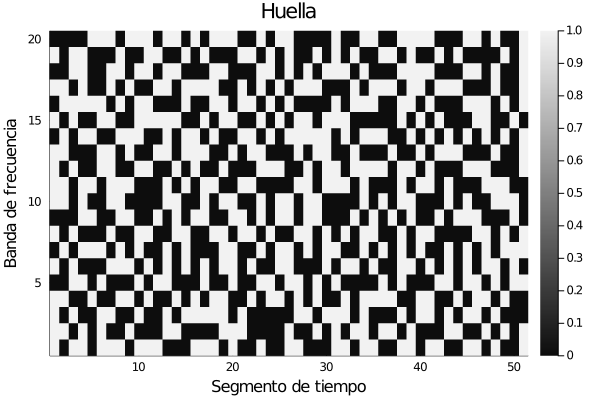

In [35]:
heatmap(
    H, 
    legend=true,
    xlabel = "Segmento de tiempo",
    ylabel = "Banda de frecuencia",
    title = "Huella",
    c = :grays
)

## Confección de la base de datos

En principio, la base de datos simplemente debe

* Guardar, para cada *frame*,
  * las características obtenidas,
  * un identificador de la canción de la cual provino,
  * el número de *frame* dentro de la canción.
* Permitir buscar el identificador de canción y el número de *frame* a partir de una característica, o informar si la característica buscada no se encuentra en la base de datos.

Así, cuando se desea identificar una música desconocida, se calculan las características de cada *frame*, se obtienen los identificadores de la base, y se opera con ellos de algún modo razonable para devolver la (o las) canciones más probables.

Ahora bien, es importante que este tipo de algoritmos escalen a bases de datos grandes y funcione rápido; para eso, es crucial que la la base de datos aproveche bien el espacio en memoria y permita una búsqueda eficiente. Por esto, se le proveen funciones que implementan una versión sencilla de una base de datos que cumple con estas características, que deberán ser entendidos.

Para confeccionar la base de datos, se utilizará la función *generar_DB*. Esta función requiere que el alumno haya definido otra una función que, dado un archivo de audio como entrada, lo pre-procese, analice y extraiga su huella digital acústica en forma automática.

#### Ejercicio 9)

***Encapsule su algoritmo de extracción de huellas acústicas en una función llamada generar_huella que reciba como entrada el path del archivo de audio y devuelva su huella digital acústica.***

Como en el ejercicio 10 vamos a calcular el overlap que vamos a utilizar para el algoritmo, definimos una función que devuelve una función `generar_huella` según el overlap.

In [36]:
function obtener_generador_huella(overlap)
    overlap = overlap
    function(path)
        data = loadaudio(path)
        mono = convertir_a_mono(data)
        submuestreada = sistema(mono)
        E = obtener_e(submuestreada, ventana, overlap)
        H = obtener_h(E)
    end
end

obtener_generador_huella (generic function with 1 method)

#### Ejercicio 10)

***Observe que la cantidad de elementos a guardar en la base de datos se incrementa conforme la longitud de las ventanas del espectrograma inicial disminuye, o el solapamiento entre ventanas se incrementa. Determine el solapamiento entre ventanas del espectrograma para obtener una densidad de aproximadamente 25 elementos por segundo y utilice este valor para el ejercicio siguiente.***

Calculamos el overlap despejando de la ecuación:

$$
sample\_rate = (long\_ventana - overlap) \cdot 25
$$
Y luego obtenemos la función `generar_huella` con ese overlap

In [37]:
function calcular_overlap()
    sample_rate = sr/8
    long_ventana - sample_rate/25
end;

In [38]:
generar_huella = let
    overlap = calcular_overlap()
    obtener_generador_huella(overlap)
end;

#### Ejercicio 11)

***Ejecute la función*** generar_DB ***para confeccionar la base de datos completa de su lista de canciones. Utilice al menos 40 canciones para llenar la base de datos.***

In [39]:
# Código de `generar_DB`
begin
    "Guarda la información para identificar un frame"
    struct FrameID
        songID     :: UInt16
        frameindex :: UInt32 # índice dentro de la base de datos
    end

    "Genera la base de datos a partir de la lista de archivos de audio"
    function generar_DB(songs; dir="")

        # Inicializa la base, que es un vector de 2^20 vectores de FrameIDs
        db = [ copy(FrameID[]) for _ in 1:2^20]


        for songid in 1:length(songs) # Para cada canción

            # Genera la huella
            huella = generar_huella(joinpath(dir, songs[songid]))

            # La agrega a la base de datos
            for i in 1:size(huella, 2) # Para cada frame en la huella de la canción
                # Agregar el landmark (huella del frame) a la base
                addlandmark!(db, huella[:, i], songid, i)
            end
        end

        return db
    end



    # Agrega el landmark (huella de un frame) a la base de datos, asociado a la
    # canción con ID `songid` y número de frame `frameidx`.
    function addlandmark!(db, lm, songid, frameidx)
        fr = FrameID(songid, frameidx)
        idx = landmark_to_index(lm)
    push!(db[idx], fr)
    end

    # convertir un landmark -- vector de 20 bools -- en un entero 
    # con esa representación binaria
    landmark_to_index(h) = sum(2 .^ (0:19) .* h) + 1
end;

In [40]:
db = generar_DB(songs);

# Test del algoritmo

En esta etapa final, pondremos a prueba la eficacia del algoritmo completo de reconocimiento. El procedimiento consistirá en obtener el porcentaje de aciertos del método al reconocer segmentos de audio, los cuales serán sometidos a distintas distorsiones.

Para esto se suministra la función *query_DB*, la cual recibe como entradas la base de datos y la huella acústica del segmento de audio a reconocer, y devuelve el IDs de la canción que mejor coincide con la huella. Para entender cómo opera esta función, lea el Apéndice y el código.

#### Ejercicio 12)

***Evalúe la tasa de aciertos del algoritmo identificando segmentos de duración $T$ con tiempo inicial elegido al azar de canciones elegidas al azar (vea la función*** rand***). Las canciones deberán ser las mismas que utilizó para confeccionar la base de datos. Realice la evaluación para 50 segmentos con duración $T$  entre 5, 10 y 20 segundos cada vez (150 evaluaciones en total) obteniendo la tasa de aciertos en cada caso.***

In [41]:
function query_DB(db, huella::AbstractMatrix)

    # Cantidad de landmarks en la huella
    n = size(huella, 2)

    # Extraigo la información de todos los frames que encajaron con algún landmark
    # Vea que puede haber más frames que landmarks si hubo firmas repetidas
    frames = [ fr for lm in eachcol(huella) for fr in db[landmark_to_index(lm)]]

    # Función que toma un songID y devuelve un puntaje según cuántas veces aparece
    # como máximo en `frames` en algún intervalo de tiempo de `n`
    function score(sid)

        # Rescato los índices de frame asociados al songID pedido
        fids = [ fr.frameindex for fr in frames if fr.songID == sid ]

        # Armo un vector con deltas de peso 1 ubicadas en los índices de frames
        aux = zeros(Int, maximum(fids))
        aux[fids] .= 1

        # Convoluciono eso con una ventana de ancho `n` y devuelvo el máximo
        return maximum(conv(ones(Int, n), aux))
    end

    # Listo todos los songIDs candidatos, borrando duplicados
    sids = union(getfield.(frames, :songID))

    # Devuelvo el songID que maximice el `score`
    return sids[findmax(score.(sids))[2]]
end;

Como la función `generar_huella` recibe la ruta de un archivo y devuelve la huella, para realizar este ejercicio necesitamos definir otra función similar pero que en lugar de tomar una ruta, tome una señal de audio. De esta forma podemos cargar un audio, obtener un segmento, y luego utilizar esta función para obtener la huella.

In [42]:
function generar_huella_(x)
    submuestreada = sistema(x)
    E = obtener_e(submuestreada, ventana, calcular_overlap())
    obtener_h(E)
end;

Para ahorrar tiempo en las pruebas, cargamos las señales de audio previamente para no tener que cargar cada cancion para cada iteración de la prueba.

In [43]:
songs_mono = map(x -> convertir_a_mono(loadaudio(x)), songs);

Ahora definimos una función que reciba una señal de audio en 1 canal y además una duración en segundos, y devuelva un segmento aleatorio de esa señal con esa duración.

In [44]:
function obtener_segmento_random(audio, duracion)
    n = length(audio)
    random_start = abs(rand(Int)%(n - sr*duracion))
    finish = random_start + duracion*sr
    audio[random_start:finish-1]
end;

Por último definimos la función que recibe una longitud de segmento en segundos y una cantidad *n*; y devuelve la tasa de aciertos de probar el algoritmo *n* veces tomando un segmento aleatorio de una canción aleatoria con la duración indicada. 

In [45]:
function probar_algoritmo(long_segmento, n)
    resultados = repeatedly(() -> let
        (song_number, audio) = rand(collect(enumerate(songs_mono)))
        segmento_random = obtener_segmento_random(audio, long_segmento)
        H = generar_huella_(segmento_random)
        query_DB(db, H) == song_number
    end, n)
    sum(resultados)/length(resultados)
end;

Finalmente probamos el algoritmo 50 veces con duraciones de segmentos de 5, 10 y 20 segundos, dando un total de 150 pruebas.

In [46]:
let 
    for long_segmento in [5, 10, 20]
        tasa_aciertos = probar_algoritmo(long_segmento, 50)
        println("Tasa de aciertos con ", long_segmento, "s: ", tasa_aciertos)
    end
end

Tasa de aciertos con 5s: 1.0
Tasa de aciertos con 10s: 1.0
Tasa de aciertos con 20s: 1.0


#### Ejercicio 13)

***Repita el ejercicio 12 sumando ruido a los segmentos de audio. Utilice la función*** randn ***para generar las muestras de ruido. Evalúe tasa de aciertos para SNR 0dB, 10dB y 20dB, mostrando sus resultados en una tabla para 9 combinaciones de longitud temporal y ruido.***

Implementamos la función `agregar_ruido`, que recibe una señal `x` y un signal-to-noise ratio `snr` en decibeles, y genera ruido tal que el SNR con `x` sea `snr`.

La idea general del algoritmo es que el SNR equivale a:

$SNR = \frac{P_x}{P_{ruido}}$

La varianza del ruido generado es:

$\sigma ^2 = \frac{\sum_i|X_i - \mu|^2}{n}$

Pero la media $\mu$ del ruido es cero ya que el generador de números aleatorios tiene distribución normal (0,1), entonces:

$\sigma ^2 = \frac{\sum_i|X_i |^2}{n} = P_{ruido}$

Entonces para que el ruido generado con distribución normal pase de tener $\sigma^2 = 1$ a tener $\sigma^2 = n_0$ lo tengo que multiplicar por $\sqrt{n_0}$, con $n_0 = \frac{P_x}{SNR}$ (esto viene de que si a una variable aleatoria con distribución normal la multiplico por un factor $a$, su varianza se multiplica por  $a^2$)

In [47]:
function agregar_ruido(x, snr)
    #convierto el SNR de decibeles a escala lineal
    linear_snr = 10^(snr/10)
    #potencia de x
    power_x = sum(abs.(x) .^ 2)/length(x)
    #n0 = Px / SNR
    n0 = power_x/linear_snr
    #genero el ruido con distribucion normal (0,1)
    #y lo multiplico por √n0
    noise = randn(length(x))*sqrt(n0)
    return x .+ noise
end;

Probamos la función `agregar_ruido` con un segmento de audio.

In [48]:
SampleBuf(agregar_ruido(mono, 20), sr)

441000-frame, 1-channel SampleBuf{Float64, 2}
10.0s sampled at 44100.0Hz
█▇▇▇██▇▇██▇█▇██▇█▇▇▇▇▇█▇▇▇▇██▇█▇▇█▇▇█▇██▇▇▇▇█▇▇▇▇▇█▇▇█▇█▇▇▇▇▇█▇▇▇▇▇█▇▇▇██▇▇█▇▇█▇

Por último definimos la función `probar_con_ruido` la cual es similar a `probar_algoritmo`, pero en este caso agrega ruido a cada segmento aleatorio obtenido con el SNR recibido como parámetro.

In [49]:
function probar_con_ruido(long_segmento, ruido_snr, n)
    resultados = repeatedly(() -> let
        (song_number, mono) = rand(collect(enumerate(songs_mono)))
        segmento_random = obtener_segmento_random(mono, long_segmento)
        señal_con_ruido = agregar_ruido(segmento_random, ruido_snr)
        H = generar_huella_(señal_con_ruido)
        return query_DB(db, H) == song_number
    end, n)
    tasa_aciertos = sum(resultados)/length(resultados)
    return tasa_aciertos
end;

Ahora probamos el algoritmo para segmentos de duración 5, 10 y 20 segundos, y SNR de 0, 10 y 20 dB.

In [50]:
R(t,s) = probar_con_ruido(t, s, 50);

In [51]:
Markdown.parse(string("
| T / SnR |0 dB       |10 dB       |20 dB       |
|----     |----       |----        |----        |
| **5s**  |",R(5,0), "|",R(5,10), "|",R(5,20), "|
| **10s** |",R(10,0),"|",R(10,10),"|",R(10,20),"|
| **20s** |",R(20,0),"|",R(20,10),"|",R(20,20),"|
"))

| T / SnR | 0 dB | 10 dB | 20 dB |
| -------:| ----:| -----:| -----:|
|  **5s** | 0.76 |  0.96 |   1.0 |
| **10s** |  0.9 |   1.0 |   1.0 |
| **20s** |  1.0 |   1.0 |   1.0 |


#### Ejercicio 14) (OPTATIVO)

***Reproduzca y grabe un segmento de alguna de las canciones e intente reconocerla con su algoritmo. Puede utilizar dispositivos como el micrófono de su PC, su teléfono celular, una radio, etc. Comente los resultados obtenidos así como las condiciones de ruido de fondo y los dispositivos utilizados. (Recuerde que su función recibe audios a 44100 Hz.)***

El segmento de audio fue grabado reproduciendo la cancion en el altavoz del celular y grabando eso con el microfono includo en los auriculares de la computadora. Luego se convirtió el archivo de wav a ogg.

El driver de audio de la computadora tiene la función de cancelar los ruidos de fondo, lo cual se cumple, pero a su vez cuando apenas se aleja el altavoz del micrófono lo empieza a tomar como ruido de fondo y lo silencia.

Muestro el audio grabado

[record.ogg](https://nextjournal.com/data/QmVFtHMyscP4ScWt98emzPmXMxmqswX5FkvyKcTS9x8ZSd?content-type=audio/ogg&node-id=b82b8589-fb17-4b6d-8d20-c9de03f27fe4&filename=record.ogg&node-kind=file)


In [52]:
SampleBuf(loadaudio(test_recording), sr)

688128-frame, 2-channel SampleBuf{Float32, 2}
15.603809523809524s sampled at 44100.0Hz
▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▅▄▄▃▁▃▃▇▇▇▆▇▆▇▇▇▇▅▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▆▆▆▇▇█▇▇▇▇▆▄▄▅▄▅▅▅▅▃▆▁▁▇▇▇▇▇
▇▇▇▇▇▇▇▇▇▇▇▇▇▆▆▅▄▄▃▁▃▃▇▇▇▆▇▆▇▇▇▇▅▇▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▆▇▇▆▆▆▇▇█▇▇▇▇▆▄▄▅▄▅▅▅▅▃▆▁▁▇▇▇▇▇

Verificamos el numero de canción buscado.

In [53]:
let
  song_number = 26
  SampleBuf(loadaudio(songs[song_number])[sr*40: sr*55], sr)
end

661501-frame, 1-channel SampleBuf{Float32, 1}
15.000022675736961s sampled at 44100.0Hz
▅▆▆▆▆▆▇▆▇▆▆▆▆▇▆▆▆▆▆▆▆▅▆▆▆▆▆▆▅▆▇▇▆▆▆▅▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▅▆▅▇▅▆▆▆▇▆▇▆▇▆▆▆▆▆▅▆▆▆▆▆▆▅▅▆

Realizamos la búsqueda en la base de datos con `query_DB()`.

In [54]:
let
    huella = generar_huella(test_recording)
    res = query_DB(db, huella)
    Int(res)
end

26

Vemos que coincide el resultado obtenido con el número de la canción, por lo cual podemos decir que el resultado fue satisfactorio.

#### Ejercicio 15) (OPTATIVO; SÓLO PARA LOS MÁS ENTUSIASTAS)

***Repita el ejercicio 12 para T=10 solamente, afectando los segmentos con otro tipos de distorsiones elegidas entre las siguientes:***

* ***Saturación***
* ***Cuantización***
* ***Cambio de velocidad***
* ***Ecualización***

***Si elige saturación y/o cuantización, muestre el efecto que ocasiona sobre el audio mediante un espectrograma. Justifique si estas distorsiones pueden considerarse o no sistemas LTI.***

#### Ejercicio 16) (OPTATIVO; SÓLO PARA LOS MÁS OBSESIVOS)

Verifique cómo cambia la tasa de aciertos cuando:

* cambia el solapamiento
* incrementa el solapamiento sólo al momento de identificar pero no al armar la base de datos
* cambia la longitud de la ventana manteniendo la tasa de *frames* por segundo
* cambia el algoritmo de extracción de características por algún otro que se le ocurra

# Apéndice

## La estructura de la base de datos

La base de datos es un vector de $2^{20}$ elementos, cada uno de los cuales es un vector de tamaño dinámico. Para cada *frame* de la huella acústica, se genera un valor a guardar en estos vectores de tamaño dinámico. El índice en el que se guarda cada valor se obtiene pasando a decimal el número binario conformado por las características del *frame* en cuestión. Note que la cantidad de elementos del vector de la base, $2^{20}$ se debe a que cada *frame* de la huella acústica posee 20 elementos binarios.

Cada valor a guardar es un objeto de tipo *FrameID*, que consiste de un entero de 32 bits sin signo, que determina el número de *frame*, y un entero de 16 bits sin signo que guarda el índice de la canción. Observe que el máximo número de canciones distintas que se podrán almacenar en esta tabla es $2^{16}$. Obserbe también que múltiples *FrameID*s de distintos *frames* pueden requerir ser guardados en la misma posición por tener la misma huella; por esto, cada elemento es un vector que puede crecer según se requiera.

Esta implementación puede ser optimizada pero es un balance razonable entre eficiencia y simpleza, suficiente para este trabajo.

## La búsqueda de la canción más probable

La búsqueda en la base de datos parte de una huella acústica de entrada y devuelve el ID de la canción más probable a la cual corresponde como salida.

Para cada *frame* de la huella se obtiene el índice del vector de la base de datos que debe consultarse, pasando la característica de cada *frame* de binario a decimal, del modo inverso que cuando se almacenan elementos en la base, y se extraen todos los elementos almacenados en esa posición. Cada uno de estos elementos posee el ID de la canción a la cual corresponde y el número del frame que le correspondía originalmente.

Una forma sencilla de decidir a qué canción corresponde la huella podría ser elegir, de todos los elementos que se extrajeron, el ID que aparezca el mayor número de veces.

Un refinamiento al criterio anterior es, dado que para cada ID se dispone del número de *frame* del cual se extrajo, quedarse con la mayor cantidad de ID dentro de un intervalo de *frames* igual a la longitud de la huella que se está consultando. Esto es lo que está implementado en la función *query_DB*.

Por ejemplo, supongamos que se realiza un *query* a la base de datos con una huella que posee una longitud de 5 *frames* y se obtienen los siguientes 7 elementos:

![sys-tpe7.png](https://nextjournal.com/data/QmWrqDXaxxMXmbQ56JmTwH8EFfAPYmkB6uGQRwtqgBCXtH?content-type=image/png&node-id=cdb72fae-3640-4020-aa00-10ad151d26ac&filename=sys-tpe7.png&node-kind=file)

Bajo el primer criterio se declararía ganador al ID 7 dado que aparece mayor cantidad de veces, pero bajo el segundo criterio se decide por el ID 3, debido a que en el intervalo de 5 *frames* que tiene la huella de entrada el ID 7 aparece como máximo 2 veces y el ID 3 aparece 3 veces.

# Bibliografía

![sys-tpe8.png](https://nextjournal.com/data/QmcYW98tYgXiX9gm4dzpWvQEjBW8dbr5bnwHkdUwRWvZE2?content-type=image/png&node-id=97ad939b-bb69-461b-83f8-6bef0d78255e&filename=sys-tpe8.png&node-kind=file)
